<a href="https://colab.research.google.com/github/arobotdinosaur/opticalroughnessestimation/blob/main/RoughnessEstimation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')
#drive.mount('/content/drive',force_remount=True)
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np
from google.colab.patches import cv2_imshow
import scipy
from scipy.optimize import minimize
!pip install circle-fit

Mounted at /content/drive


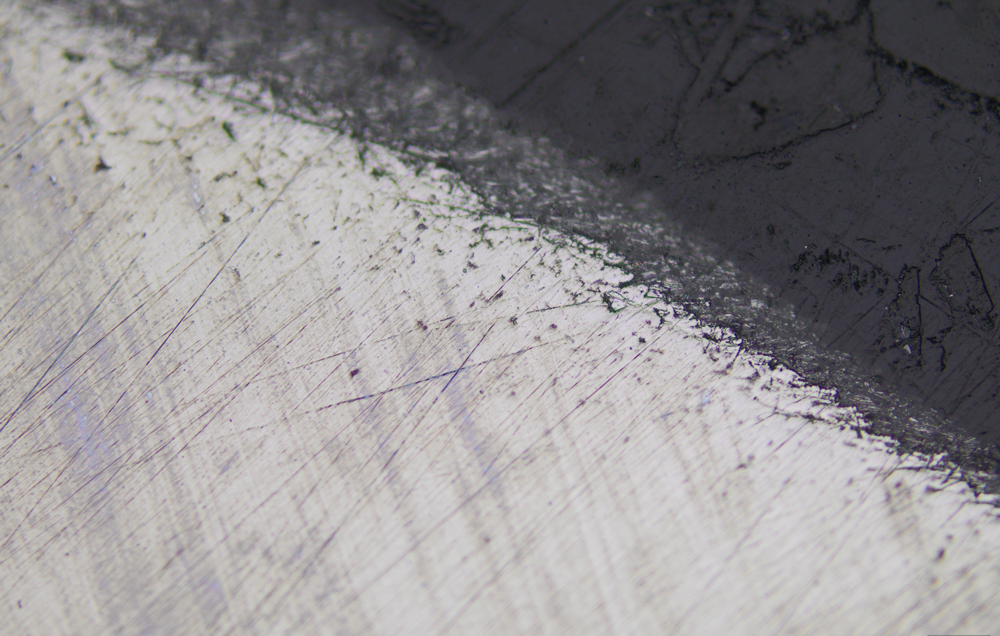

In [3]:
#img=cv2.imread('/content/drive/MyDrive/Ghazinejad Lab Drive/Sample Images A3-20x-NSP/A3_28.png')
img=cv2.imread('/content/drive/MyDrive/Ghazinejad Lab Drive/Sample Images A4-20x-SP/A4_SP_009.png')
# scale and size are the exact same between both images which is wonderful
# Crop the bottom out because the scale label was messing things up
img = img[:-110, :, :]
cv2_imshow(img)

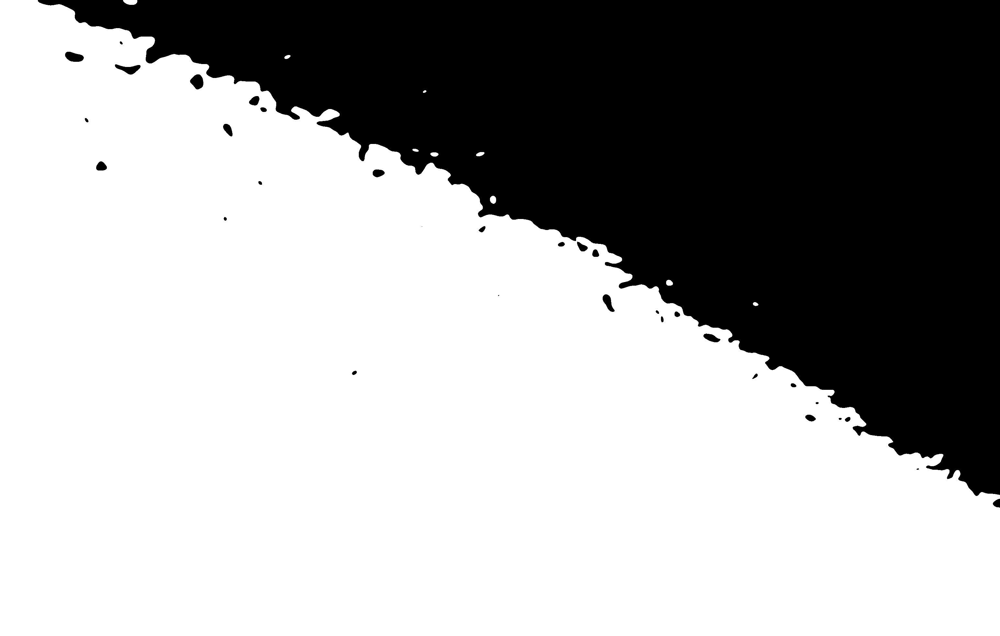

In [4]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray, (49, 49), 0) #need a LOT of blur for shot peened, should probably look in to other denoising/edge detection techniques
#blurred = cv2.GaussianBlur(gray, (5, 5), 0) #worked for not shot peened
thresholded=cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
cv2_imshow(thresholded)

In [5]:
#the erosion/dialation to get rid of outliers proved unnecessary after getting rid of the bottom text
#re-enabling this to process shot peened image
#nvm too much trouble
#thresholded=cv2.bitwise_not(thresholded)
##thresholded=cv2.erode(thresholded, np.ones((10,10),np.uint8), iterations=2)
#thresholded=cv2.dilate(thresholded, np.ones((10,10),np.uint8), iterations=2)
#cv2_imshow(thresholded)

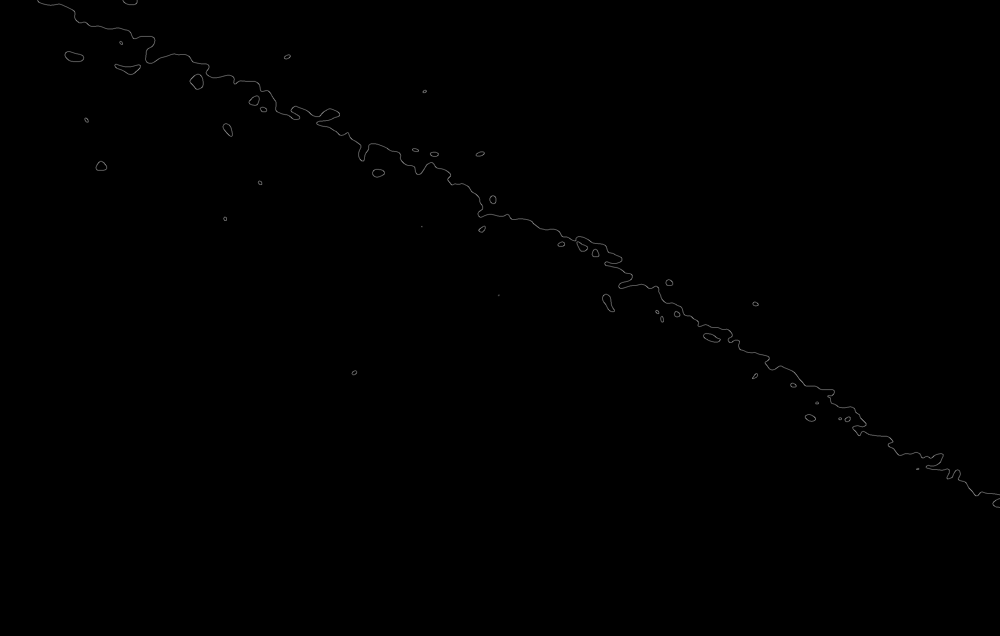

In [6]:
edges = cv2.Canny(thresholded, 70, 210)
cv2_imshow(edges)

In [7]:
# Find all contours in the edge detected image
contours, hierarchy = cv2.findContours(edges.copy(), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)

print(f"Found {len(contours)} contours.")

# List information about each contour
for i, contour in enumerate(contours):
    area = cv2.contourArea(contour)
    print(f"Contour {i+1}: has {len(contour)} points, area = {area:.2f}")

# Optional: Draw all contours on a copy of the original image
# img_with_all_contours = img.copy()
# cv2.drawContours(img_with_all_contours, contours, -1, (0, 255, 0), 2) # Draw all contours in green
# cv2_imshow(img_with_all_contours)
largest_contour=max(contours, key=len) #the idea here is to ignore all the miniature pores, and just use the edge

Found 82 contours.
Contour 1: has 58 points, area = 9.00
Contour 2: has 9 points, area = 19.50
Contour 3: has 11 points, area = 21.00
Contour 4: has 7 points, area = 41.00
Contour 5: has 14 points, area = 44.00
Contour 6: has 15 points, area = 172.50
Contour 7: has 29 points, area = 182.50
Contour 8: has 30 points, area = 461.00
Contour 9: has 42 points, area = 478.00
Contour 10: has 12 points, area = 41.50
Contour 11: has 13 points, area = 43.50
Contour 12: has 12 points, area = 154.00
Contour 13: has 23 points, area = 162.00
Contour 14: has 23 points, area = 124.00
Contour 15: has 28 points, area = 133.50
Contour 16: has 18 points, area = 128.00
Contour 17: has 26 points, area = 133.00
Contour 18: has 58 points, area = 830.00
Contour 19: has 67 points, area = 845.50
Contour 20: has 15 points, area = 113.50
Contour 21: has 19 points, area = 116.50
Contour 22: has 20 points, area = 214.00
Contour 23: has 33 points, area = 221.00
Contour 24: has 8 points, area = 64.50
Contour 25: has 17

In [8]:
# Assuming largest_contour has been found and is available

if 'largest_contour' in locals() and largest_contour is not None:
    # Extract points from the largest contour
    # The contour points are in the format [[[x, y]]], so we reshape to (N, 2)
    point_coordinates = largest_contour.reshape(-1, 2)

    print(f"Generated point_coordinates with {len(point_coordinates)} points from the largest contour.")
    #print(point_coordinates[:10])    # show first 10 points
else:
    point_coordinates = np.array([])
    print("largest_contour is not available or is empty. Could not generate point_coordinates.")

Generated point_coordinates with 4487 points from the largest contour.


In [9]:
#this one worked well for the non shot peened case, but I think the contour implementation is more robust
#print(edges)
#ys, xs = np.where(edges > 0)

# Stack into (N,2) array of (x,y)
#point_coordinates = np.column_stack((xs, ys))

#print(point_coordinates.shape)   # (N, 2)
#print(point_coordinates[:10])    # show first 10 points

# Clear the previous plot
#plt.clf()

# Plot the points as a scatter plot
#plt.scatter(point_coordinates[:, 0], point_coordinates[:, 1], s=1) # s is marker size

# Invert the y-axis to match image coordinates (optional, depending on desired visualization)
#plt.gca().invert_yaxis()
#plt.title("Extracted Edge Points")
#plt.xlabel("X-coordinate")
#plt.ylabel("Y-coordinate")
#plt.show()

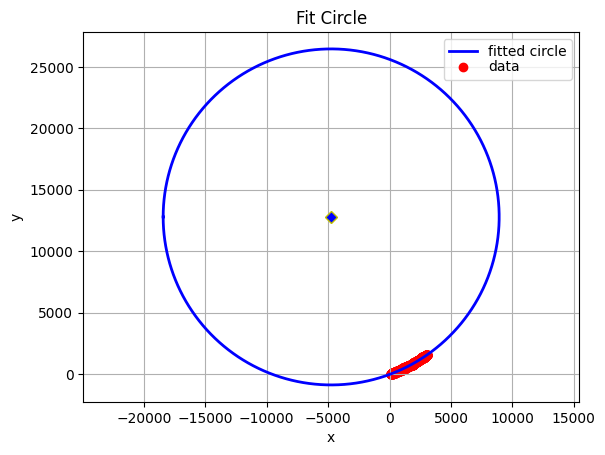

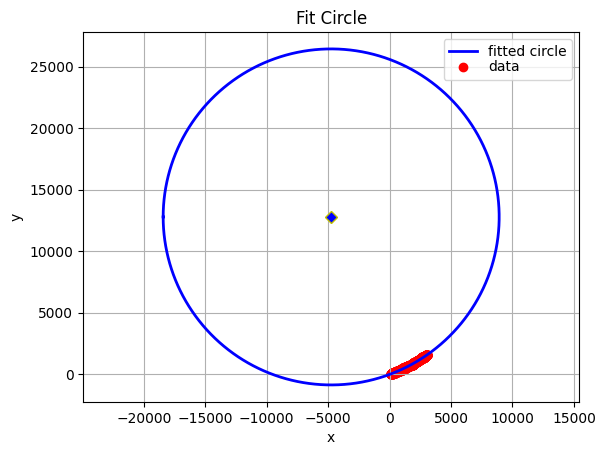

In [10]:
import circle_fit
from circle_fit import taubinSVD
from circle_fit import standardLSQ
from circle_fit import plot_data_circle
xc, yc, r, sigma = standardLSQ(point_coordinates)
xd,yd,rd,sigmad=taubinSVD(point_coordinates)
plot_data_circle(point_coordinates, xc, yc, r)
plot_data_circle(point_coordinates, xd, yd, rd)

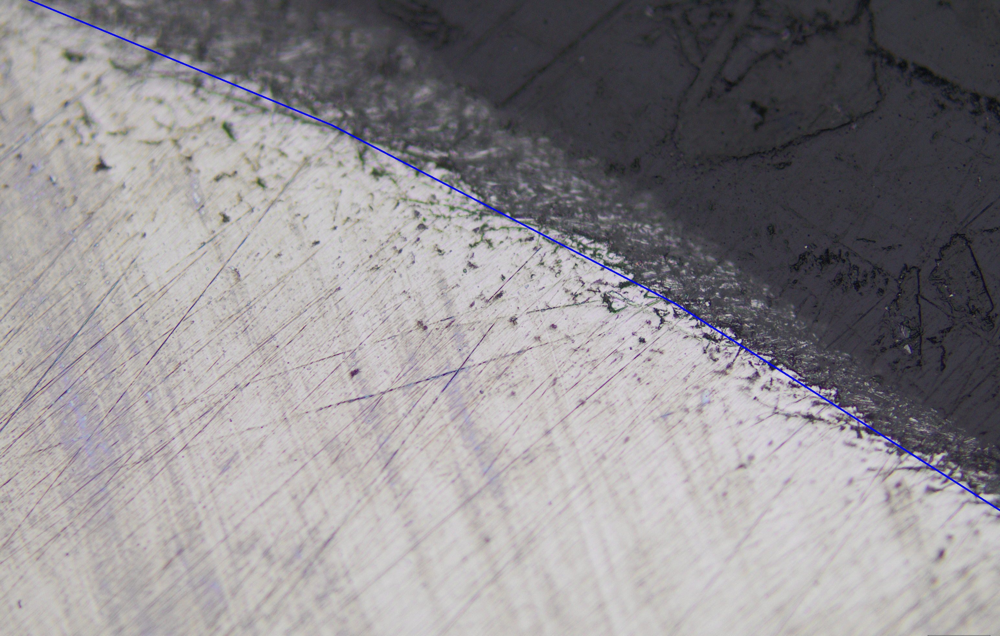

In [11]:
# Use the parameters from the standardLSQ fit (xc, yc, r)
# Or use parameters from taubinSVD fit (xd, yd, rd)
# Let's use the standardLSQ parameters for this example

output_img_circle_fit = img.copy()

# Draw the fitted circle from standardLSQ in blue
# Ensure center coordinates are integers
center_x_lsq = int(xc)
center_y_lsq = int(yc)
radius_lsq = int(r)

cv2.circle(output_img_circle_fit, (center_x_lsq, center_y_lsq), radius_lsq, (255, 0, 0), 3)

cv2_imshow(output_img_circle_fit)

In [12]:
# Find contours in the edge detected image
#contours, hierarchy = cv2.findContours(edges.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Assuming the largest contour is the main boundary
#if contours:
#    main_contour = max(contours, key=cv2.contourArea)
#    print(f"Found a main contour with {len(main_contour)} points.")

    # Highlight the main contour on the original image
#    img_with_contour = img.copy()
#    cv2.drawContours(img_with_contour, [main_contour], -1, (0, 255, 0), 3) # Draw contour in green with thickness 3
#    cv2_imshow(img_with_contour)

#else:
#    main_contour = None
#    print("No contours found.")

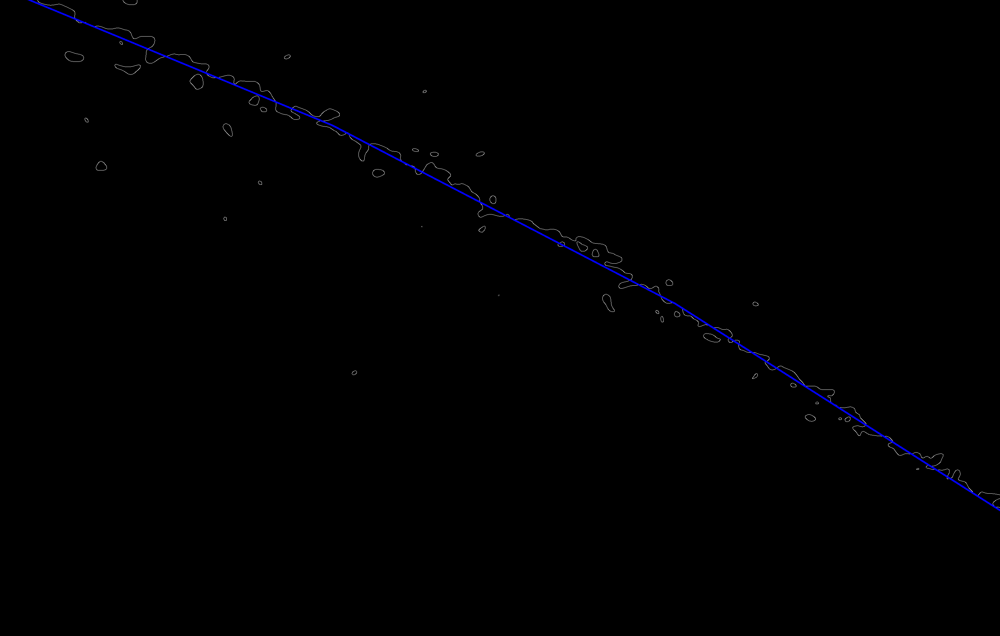

Average absolute orthogonal distance to the fitted circle: 15.91 pixels


In [13]:
# Overlay the fitted circle on the edges image
edges_with_circle = cv2.cvtColor(edges, cv2.COLOR_GRAY2BGR) # Convert edges to BGR to draw color circle
cv2.circle(edges_with_circle, (int(xc), int(yc)), int(r), (255, 0, 0), 3) # Draw the circle in blue
cv2_imshow(edges_with_circle)

# Calculate the average absolute orthogonal distance
# We'll iterate through the points in the main_contour and calculate the distance to the fitted circle

distances = []
alldistancesigned=[]
#for point in main_contour[:, 0, :]:
for point in (point_coordinates):
    distance = abs(np.sqrt((point[0] - xc)**2 + (point[1] - yc)**2) - r)
    distancesigned=(np.sqrt((point[0] - xc)**2 + (point[1] - yc)**2) - r)
    alldistancesigned.append(distancesigned)
    distances.append(distance)

average_distance = np.mean(distances)
print(f"Average absolute orthogonal distance to the fitted circle: {average_distance:.2f} pixels")

In [14]:
#possible ratios of pixels/micrometer below. Depends if the microscope was correct, at half resolution, or at whole resolution
#figured out with imagej
correct=8.25 #pixels/micrometer
doublemag=4.125 #pixels/micrometer
halfmag=16.5 #pixels/micrometer

umdist=np.array(distances) / correct
ra=average_distance / correct

# Convert alldistancesigned to a NumPy array for easier sorting
alldistancesigned_array = np.array(alldistancesigned)

# Sort the signed distances
sorted_distances = np.sort(alldistancesigned_array)

print(f"Average absolute orthogonal distance to the fitted circle: {ra:.2f} micrometers")

# Print the 5 smallest signed distances in micrometers
print("\n5 smallest signed distances (micrometers):")
print(sorted_distances[:5] / correct)

# Print the 5 largest signed distances in micrometers
print("\n5 largest signed distances (micrometers):")
print(sorted_distances[-5:] / correct)
np.set_printoptions(threshold=1000000)
#print(alldistancesigned_array/correct)

Average absolute orthogonal distance to the fitted circle: 1.93 micrometers

5 smallest signed distances (micrometers):
[-7.27823777 -7.2259773  -6.99247866 -6.96456626 -6.91226231]

5 largest signed distances (micrometers):
[6.2757226  6.2757226  6.28644355 6.28644355 6.29720858]


-4753.719350825219
12781.819775373631
13675.125416239714


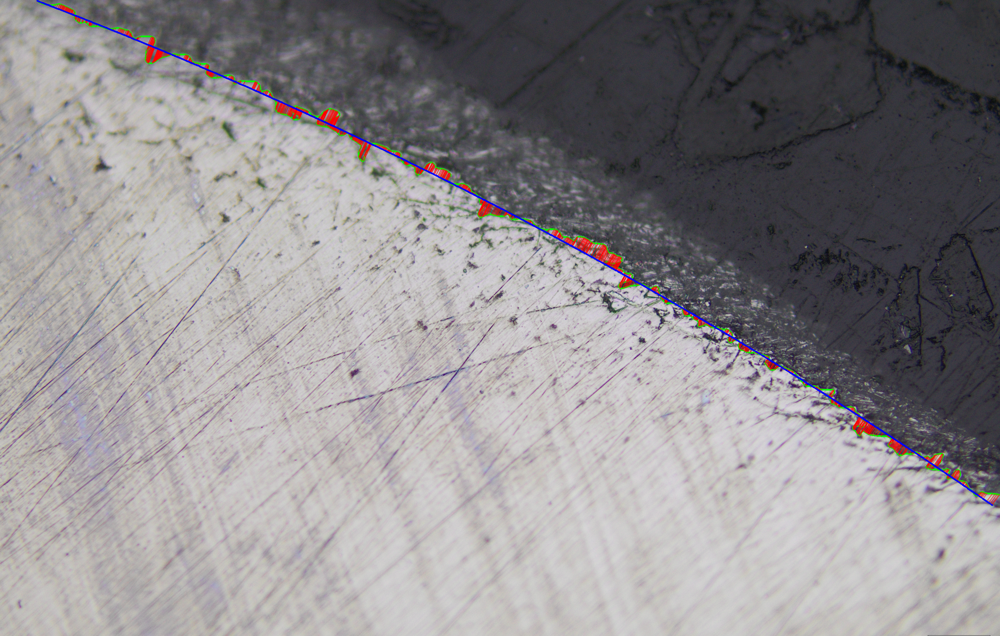

In [18]:
# Visualize the shortest distance lines
output_img_distances = img.copy()
cv2.drawContours(output_img_distances, [point_coordinates], -1, (0, 255, 0), 3) # Original contour in green

# Get the fitted circle parameters
center_x, center_y, radius = xc, yc, r # Using parameters from standardLSQ fit
print(center_x)
print(center_y)
print(radius)

# Draw the fitted circle in blue
#cv2.circle(output_img_distances, (int(center_x), int(center_y)), int(radius), (255, 0, 0), 3)

# Collect the points where the distance lines meet the circle
circle_intersection_points = []

# Draw lines representing the shortest distances
for point in point_coordinates:
    p_x, p_y = point

    # Calculate the vector from the circle center to the contour point
    vector_x = p_x - center_x
    vector_y = p_y - center_y

    # Calculate the distance from the center to the contour point
    dist_to_center = np.sqrt(vector_x**2 + vector_y**2)

    # Handle the case where the contour point is exactly at the center (though unlikely for a contour)
    if dist_to_center == 0:
        closest_point_on_circle_x = center_x + radius
        closest_point_on_circle_y = center_y
    else:
        # Calculate the closest point on the circle
        # This point lies on the line segment connecting the center and the contour point
        closest_point_on_circle_x = center_x + (vector_x / dist_to_center) * radius
        closest_point_on_circle_y = center_y + (vector_y / dist_to_center) * radius

    # Add the intersection point to the list
    circle_intersection_points.append([int(closest_point_on_circle_x), int(closest_point_on_circle_y)])

    # Draw a line from the contour point to the closest point on the circle
    cv2.line(output_img_distances, (p_x, p_y), (int(closest_point_on_circle_x), int(closest_point_on_circle_y)), (0, 0, 255), 1) # Draw line in red


# Convert the list of points to a NumPy array in the correct format for cv2.drawContours
circle_contour = np.array(circle_intersection_points).reshape((-1, 1, 2)).astype(np.int32)

# Draw the contour of the circle intersection points in blue
cv2.drawContours(output_img_distances, [circle_contour], -1, (255, 0, 0), 3) # Draw contour in blue with thickness 3


cv2_imshow(output_img_distances)

In [16]:
from scipy.signal import argrelextrema

# Find the indices of local maxima and minima
local_max_indices = argrelextrema(alldistancesigned_array, np.greater, axis=0, order=10)
local_min_indices = argrelextrema(alldistancesigned_array, np.less, axis=0, order=10)

# Get the values of local maxima and minima
#local_maxima = alldistancesigned_array[local_max_indices]
#local_minima = alldistancesigned_array[local_min_indices]

local_extrema = alldistancesigned_array[np.concatenate((local_max_indices[0], local_min_indices[0]))]


print("\nLocal Extrema (in micrometers):")
print(local_extrema / correct)

#print("\nLocal Maxima (in micrometers):")
#print(local_maxima / correct)

#print("\nLocal Minima (in micrometers):")
#print(local_minima / correct)


Local Extrema (in micrometers):
[ 2.0121377   2.19721244  3.44078575  2.07908237  1.89790995  1.54529871
  3.15230029  1.9084557  -3.34591205  1.18429898  5.63753119 -1.04863336
  0.17694035  1.20463297  1.61895908 -0.61716844  3.74177511  3.46110128
  1.86375366 -0.73798883  1.16108248  2.67767365  5.11262888  6.28644355
  5.23869169  1.26195748  1.56980734  2.28960802  0.16546408 -1.01246237
  1.72075516  0.23409453  0.86009273  0.94674078  3.07514226  1.49042228
 -0.50806727 -3.18465206  0.65669758  5.31447692  1.81560395  3.6945627
  1.38956331  4.84038783  1.42653888  3.73083253  1.85132164  5.34938614
  0.69041129 -0.47642229  1.51927505  3.10238386  0.97120034  0.88287036
  0.25483357  1.74059018 -0.99498039  0.18205623  2.3043821   1.58280794
  5.25065632  6.29720858  5.12230581  2.6854533   1.16713319 -0.7332968
  1.86537494  3.46112886  3.74177511 -0.61716844  1.61895908  1.20463297
  0.17694035 -1.04863336  5.63753119  1.18429898 -3.34591205  1.9084557
  3.15230029  1.54529